# Image Segmentation - part 3

In [ ]:
import os
import skimage
from skimage.color import rgb2gray
import matplotlib.pyplot as plt

# setting the plot size
fig,axes = plt.subplots(nrows = 10, ncols = 2, figsize=(20,80))

# loading images from folder
list_files = os.listdir('images')
image_list = []
for filename in list_files:
    image_list.append(skimage.io.imread('images\\' + filename))

# Unsupervised Segmentation

### Mark Boundaries 

This technique produces an image with highlighted borders between labeled areas, where the pictures were segmented using the SLIC method. 

We cluster the image into 100 segments with compactness = 1 and this segmented image will act as a labeled array for the mark_boundaries() function. Each segment of the clustered image is differentiated by an integer value and the result of mark_boundaries is the superimposed boundaries between the labels.

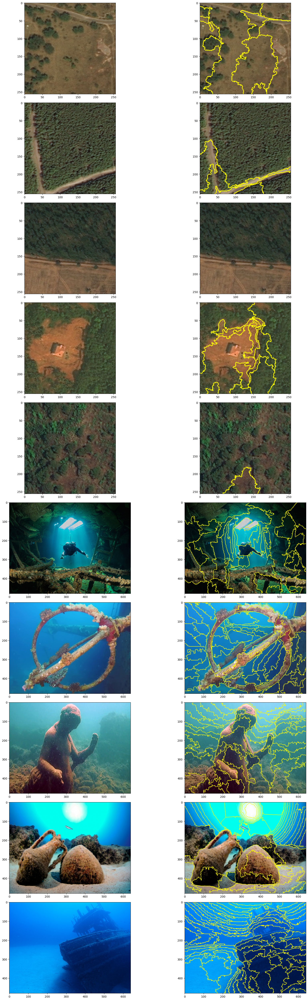

In [5]:
from skimage.segmentation import slic, mark_boundaries

# setting the plot size
fig,axes = plt.subplots(nrows = 10, ncols = 2, figsize=(20,50))

# displaying the images
for idx, image in enumerate(image_list):
    # Applying SLIC segmentation for the edges to be drawn over
    img_segments = slic(image,n_segments=100,compactness=1) # n_segments=100
    # Plotting
    axes[idx,0].imshow(image)
    axes[idx,1].imshow(mark_boundaries(image, img_segments))

plt.tight_layout()

### Simple Linear Iterative Clustering

By combining pixels in the image plane based on their color similarity and proximity, this method generates superpixels. Simple Linear Iterative Clustering is the most up-to-date approach for segmenting superpixels, and it takes very little computing power. In a nutshell, the technique clusters pixels in a five-dimensional color and picture plane space to create small, nearly uniform superpixels.

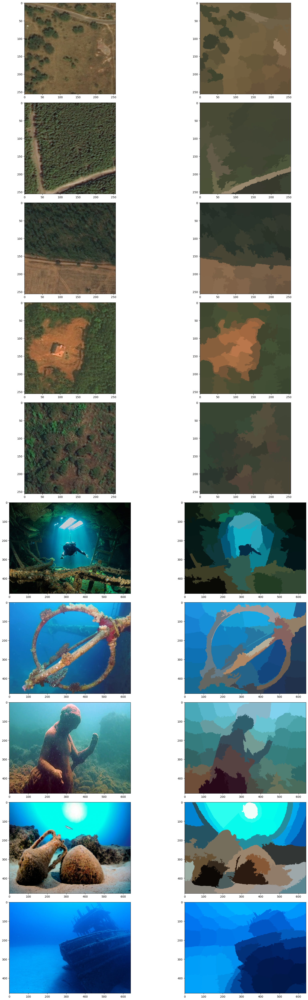

In [5]:
from skimage.segmentation import slic
from skimage.color import label2rgb

# setting the plot size
fig,axes = plt.subplots(nrows = 10, ncols = 2, figsize=(20,50))

# displaying the images
for idx, image in enumerate(image_list):
    # Applying SLIC segmentation for the edges to be drawn over
    img_segments = slic(image,n_segments=50,compactness=10)
    # Plotting
    axes[idx,0].imshow(image)
    # Converts a label image into an RGB color image for visualizing the labeled regions.
    axes[idx,1].imshow(label2rgb(img_segments,image,kind = 'avg'))

plt.tight_layout()

### Felzenszwalb’s Segmentation 

Graph-based picture segmentation.

It produces an over-segmentation of an RGB picture on the image grid using a quick, minimal spanning tree-based clustering.

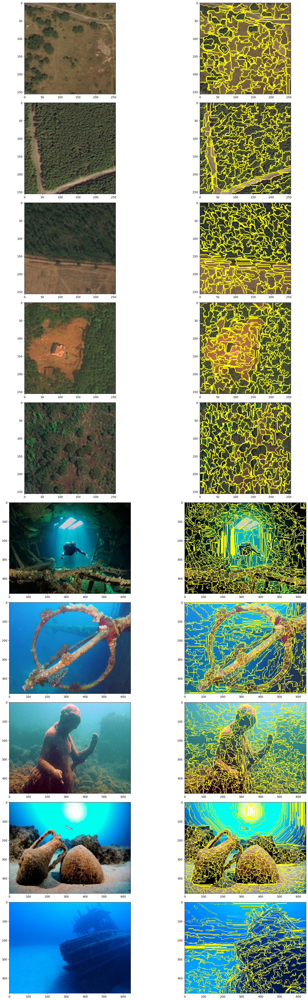

In [2]:
from skimage.segmentation import felzenszwalb, mark_boundaries
from skimage.color import label2rgb

# setting the plot size
fig,axes = plt.subplots(nrows = 10, ncols = 2, figsize=(20,50))

# displaying the images
for idx, image in enumerate(image_list):
    # Applying SLIC segmentation for the edges to be drawn over
    img_segments = felzenszwalb(image,scale = 5,sigma=2,min_size=100)  # image,scale = 2,sigma=5
    # Plotting
    axes[idx,0].imshow(image)
    # Converts a label image into an RGB color image for visualizing the labeled regions.
    axes[idx,1].imshow(mark_boundaries(image,img_segments))

plt.tight_layout()